In [41]:
import numpy as np
import itertools
import networkx as nx
from networkx.algorithms import community
import matplotlib.pyplot as plt
%matplotlib inline

In [42]:
def adj_mat_to_graph(A,percentile):
    edge_weights = map(lambda i: abs(i[2]['weight']), nx.from_numpy_matrix(A).edges.data())
    thresh = np.percentile(edge_weights,percentile)
    A_thresh = np.copy(A)
    A_thresh[abs(A_thresh) < thresh] = 0
    return nx.from_numpy_matrix(A_thresh)
    
def draw_graph(G):
    fig, ax = plt.subplots(figsize=(25, 25))
    nx.draw(G, ax=ax, node_color="red", node_size=50, alpha=0.25)
    #nx.draw_spectral(G, ax=ax, node_color="red", node_size=50, alpha=0.25) #ugly
    fig.show()

def plot_hist(X,bs):
    plt.hist(X, bins=bs)
    plt.show()
    
def get_edge_weights(G):
    return map(lambda j: j[2]['weight'], G.edges.data())

84 3486


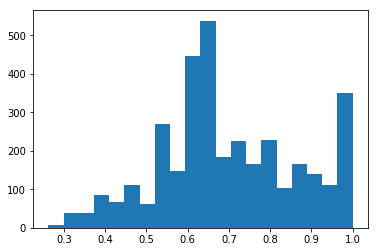

84 3486


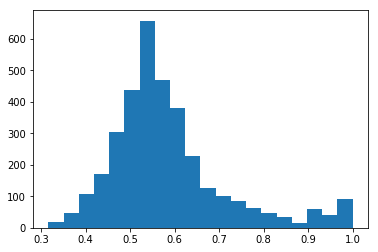

84 3486


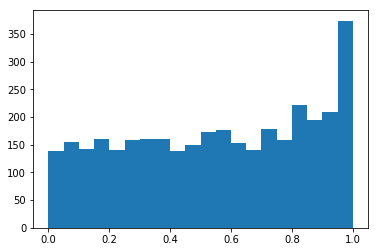

84 3486


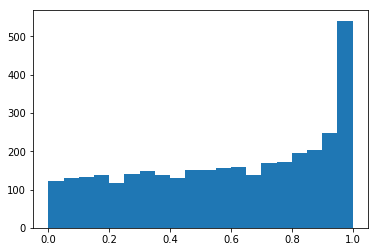

84 3486


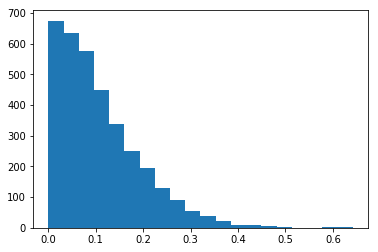

84 3486


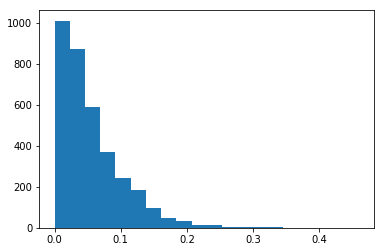

/Users/jack/miniconda2/lib/python2.7/site-packages/matplotlib/figure.py:418: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


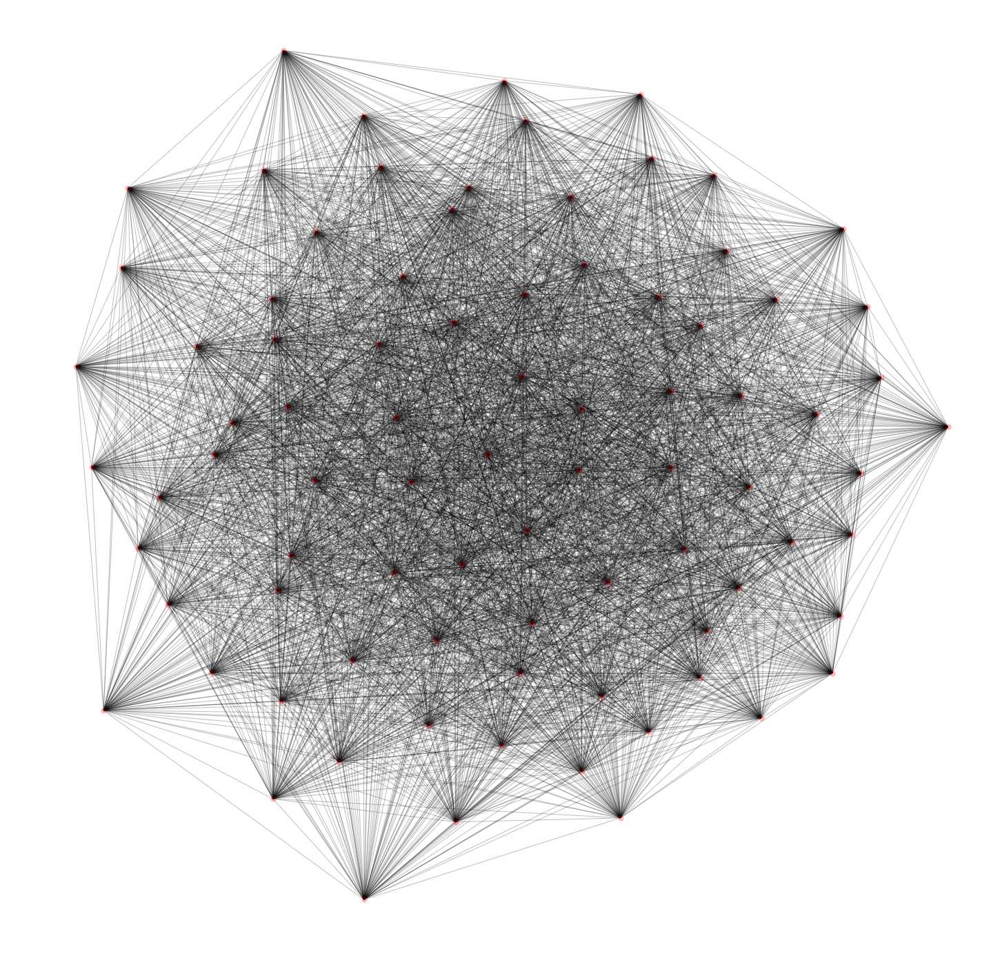

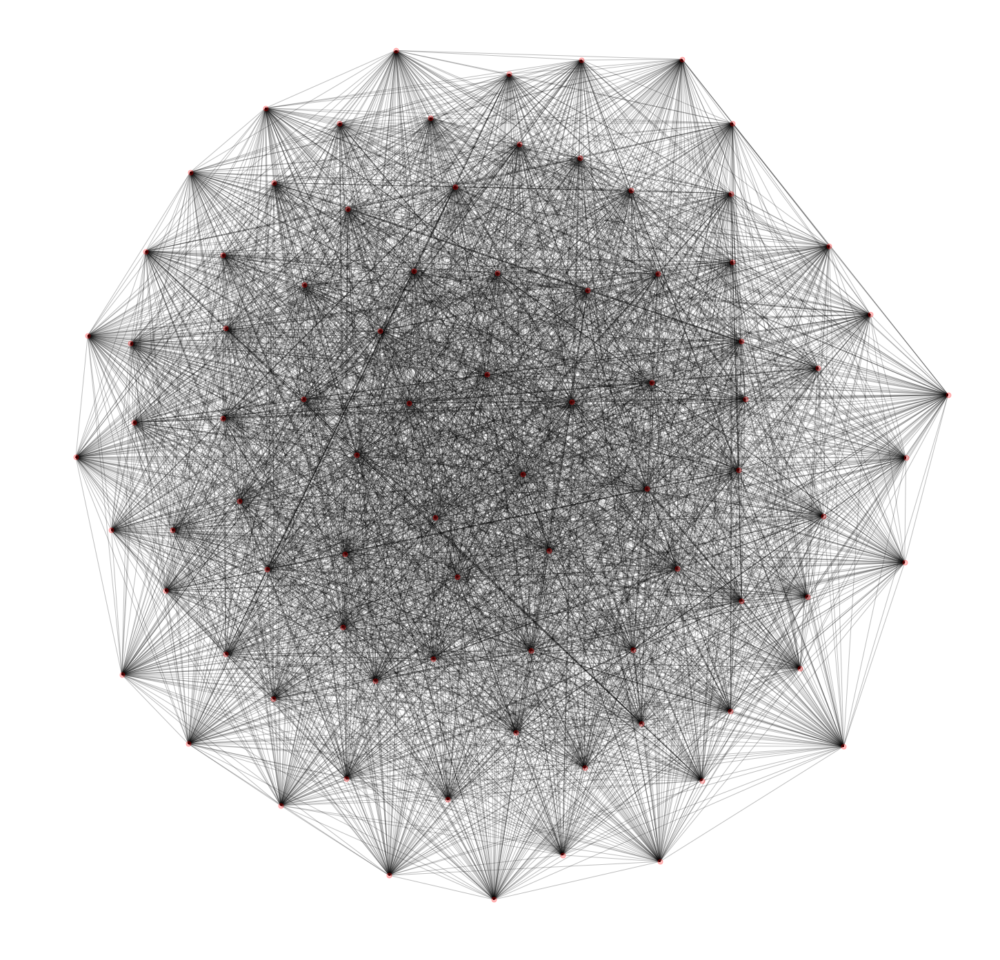

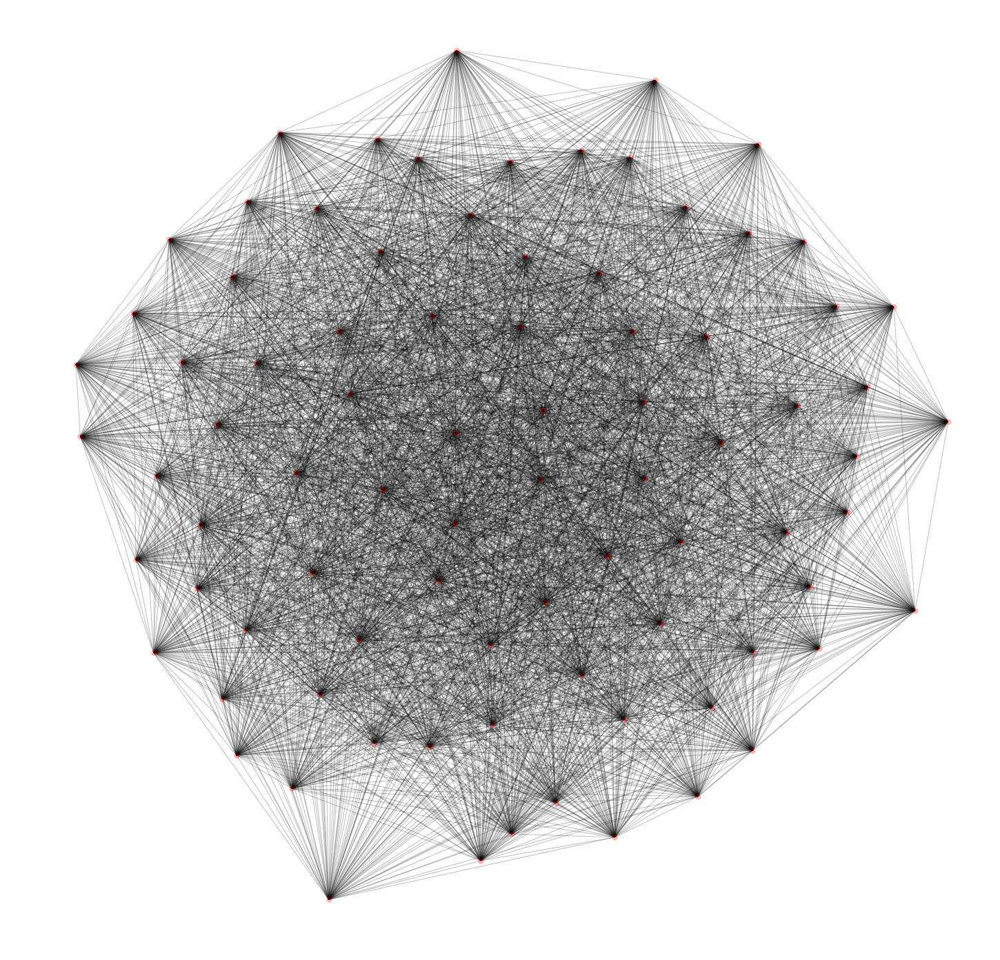

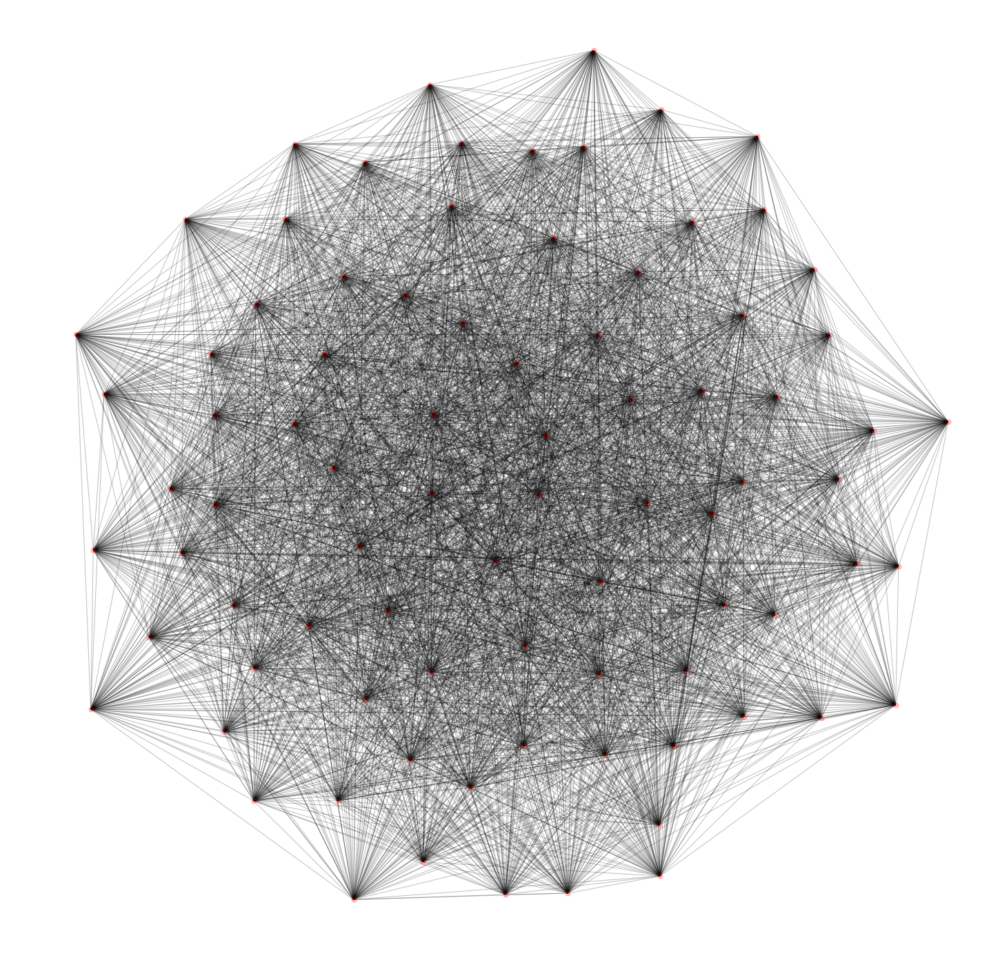

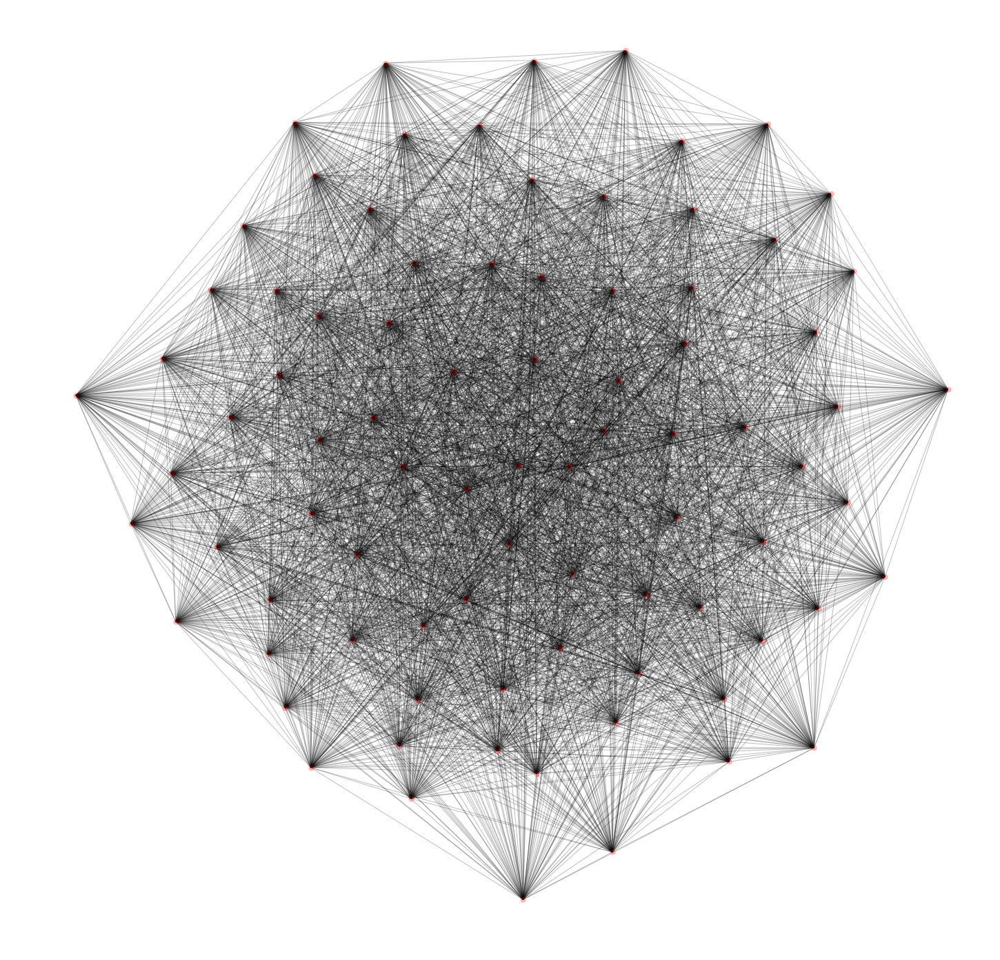

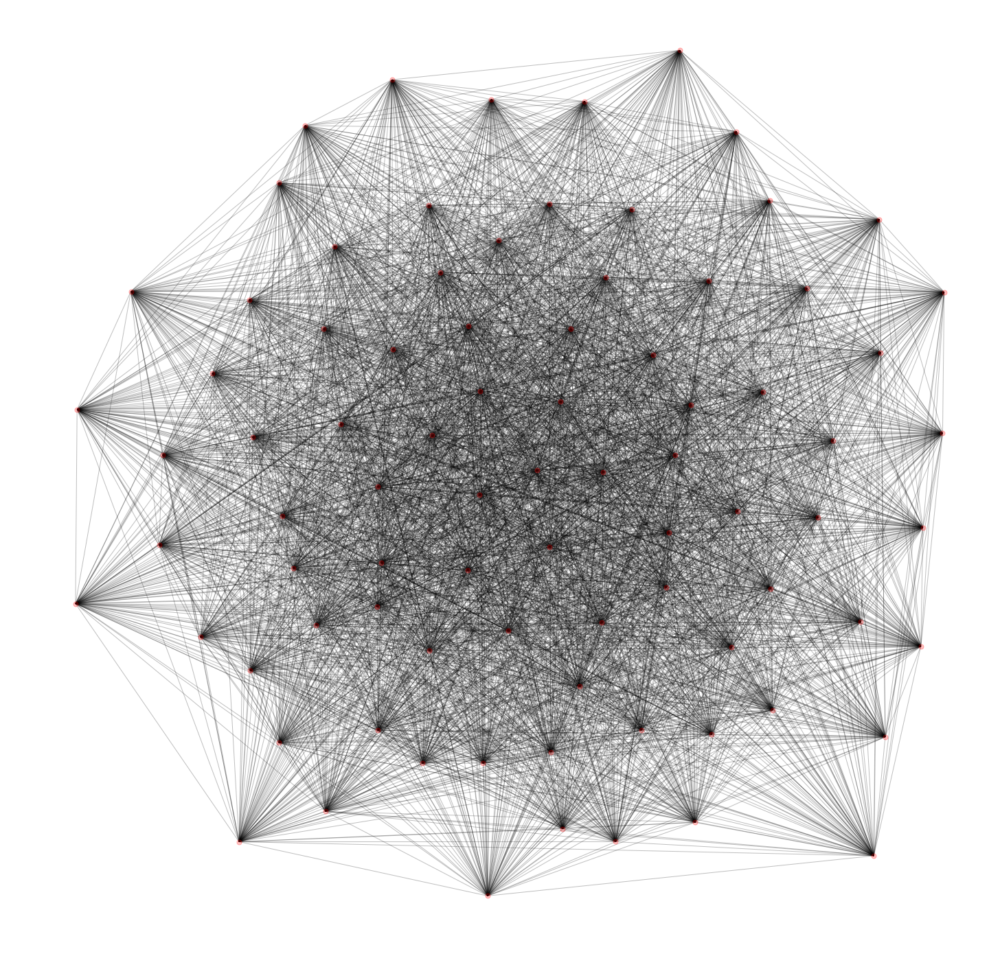

In [4]:
for i in adj_mats:
    G = adj_mat_to_graph(i,0)
    print len(G.nodes()), len(G.edges())
    plot_hist(get_edge_weights(G),20)
    
for i in adj_mats:
    G = adj_mat_to_graph(i,0)
    draw_graph(G)

84 766


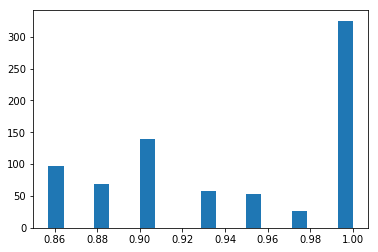

84 711


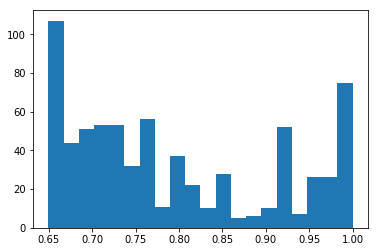

84 1248


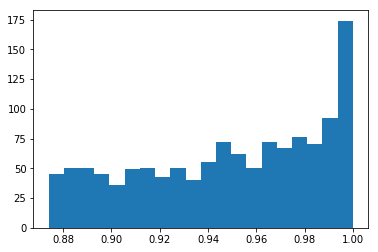

84 1193


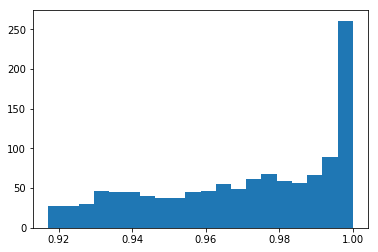

84 698


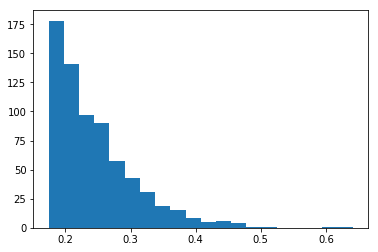

84 698


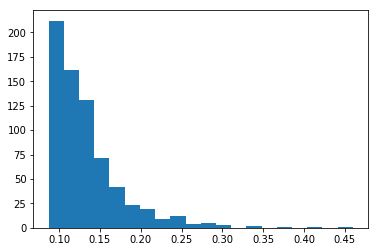

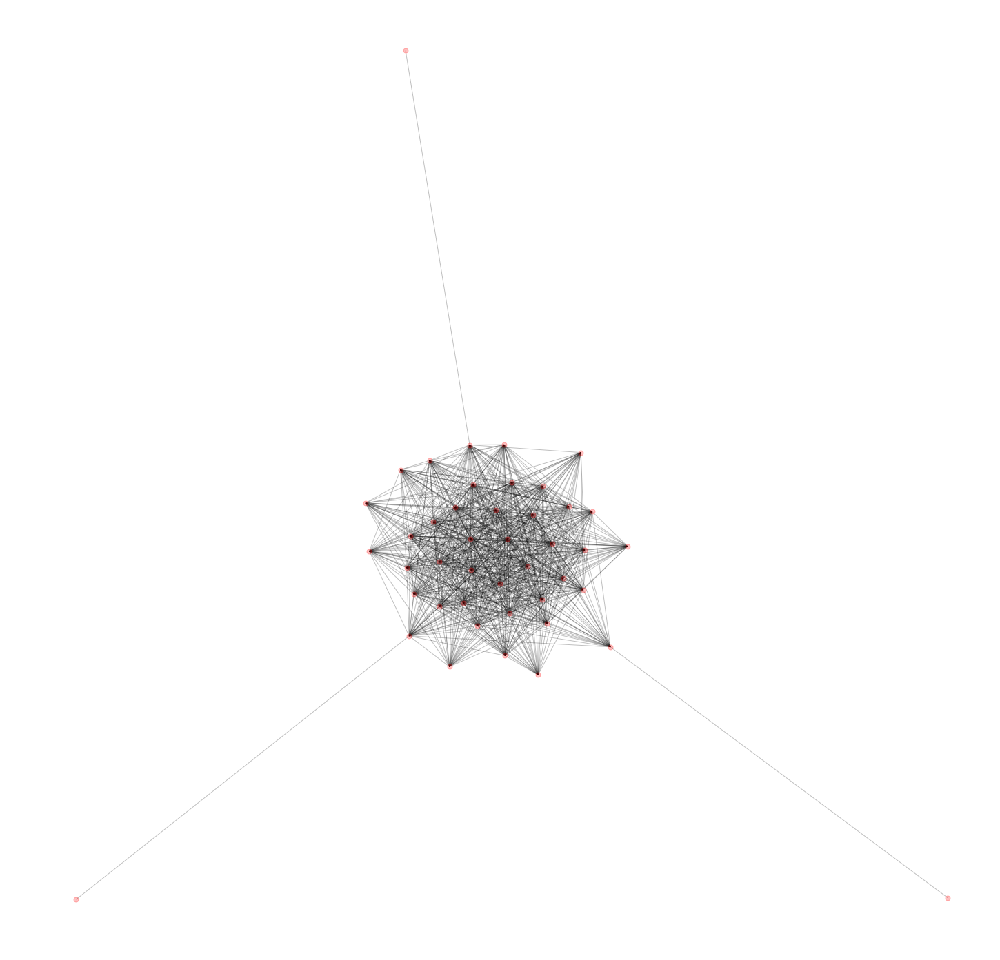

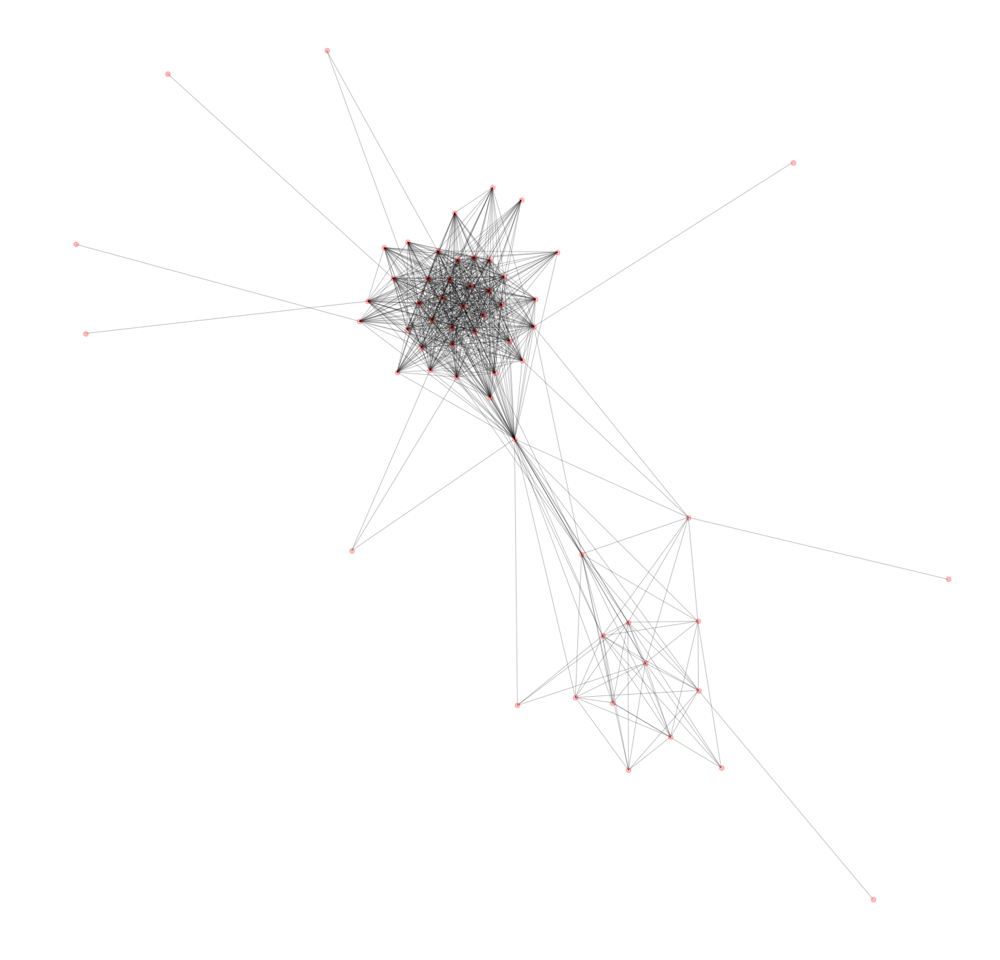

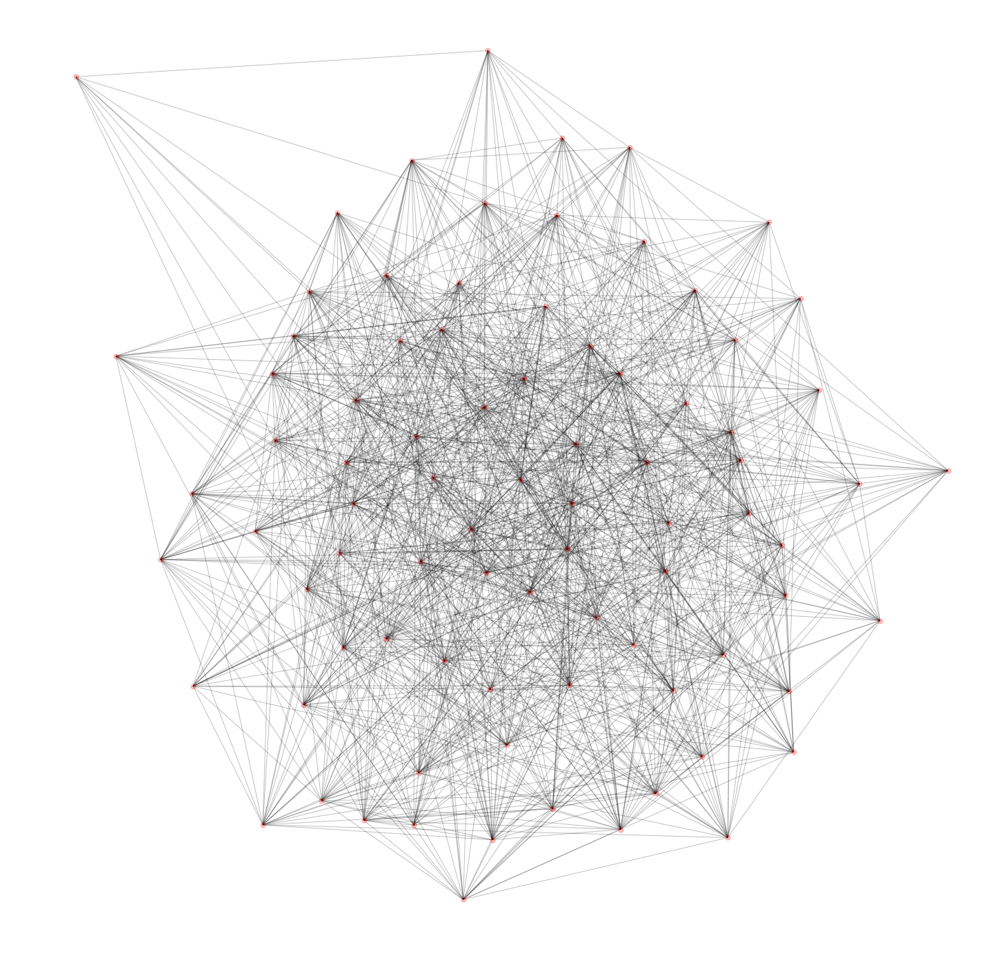

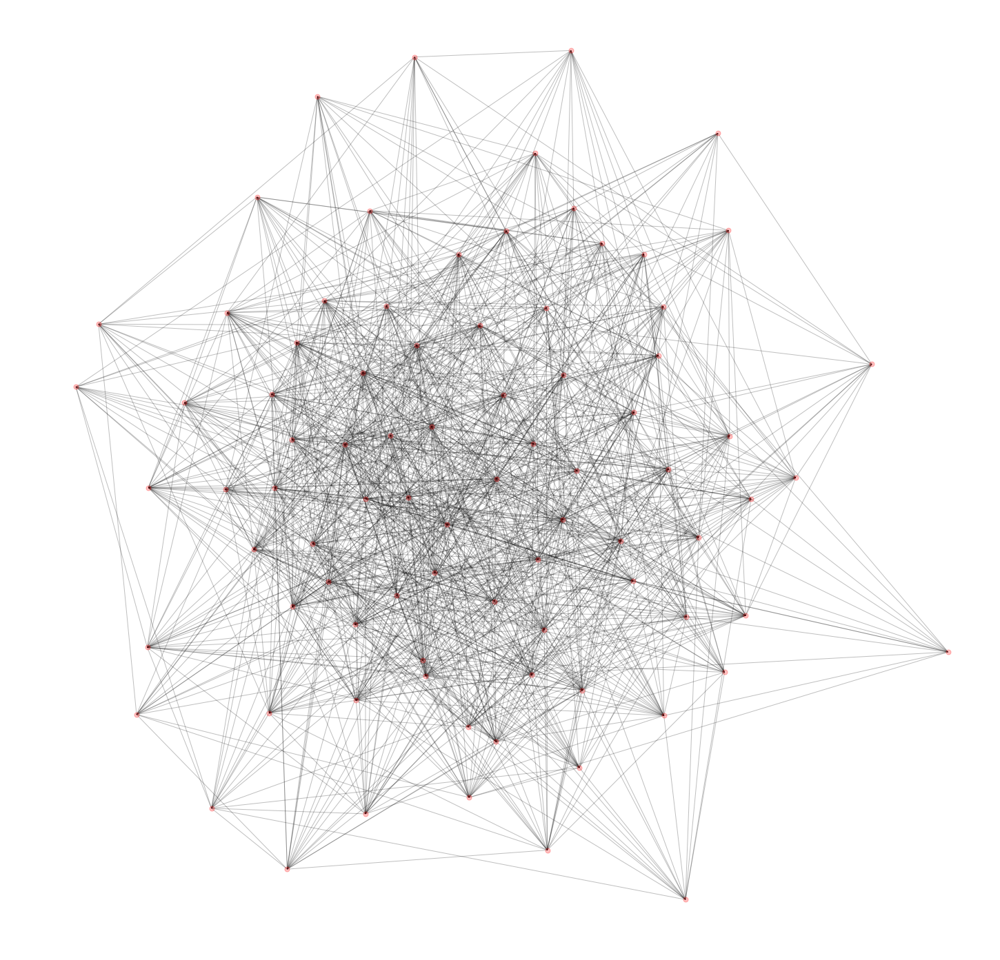

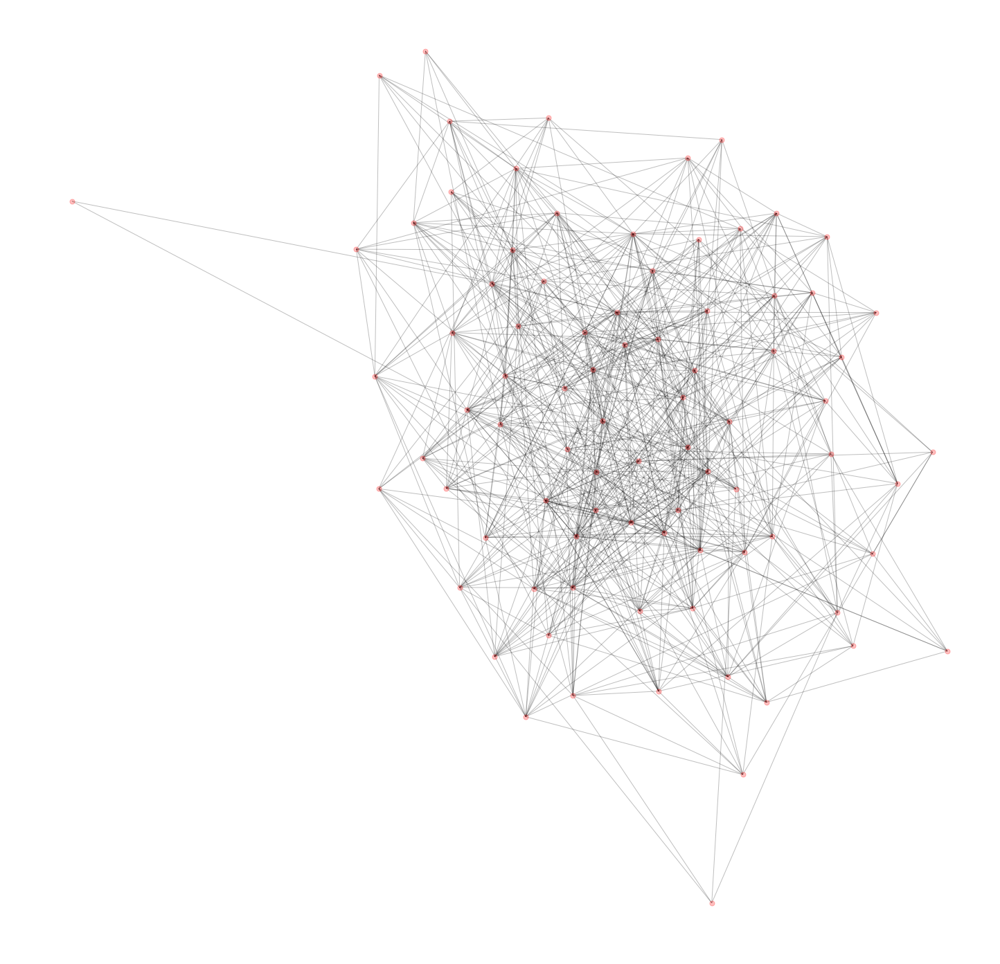

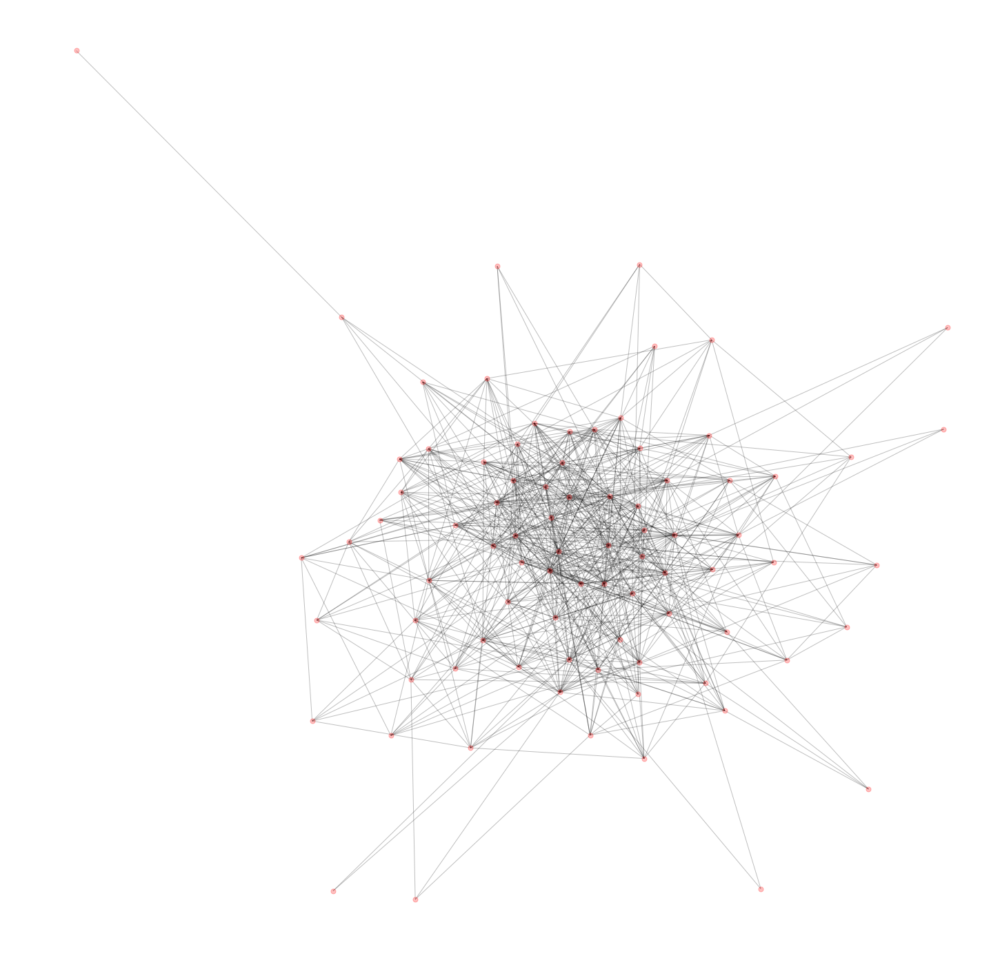

In [5]:
for i in adj_mats:
    G = adj_mat_to_graph(i,80)
    print len(G.nodes()), len(G.edges())
    plot_hist(get_edge_weights(G),20)
    
for i in adj_mats:
    G = adj_mat_to_graph(i,80)
    isol = nx.isolates(G)
    isol = list(isol)
    G.remove_nodes_from(isol)
    draw_graph(G)

In [60]:
from sklearn.cluster import SpectralClustering
from sklearn import metrics

adj_mat_dir = "./adjacency_matrices/"
adj_mat_files = ['Behavioral Prediction Similarity_Bilateral Perturbation_BAYLORGC4_2018_03_20.mat.npy',
                 'Behavioral Prediction Similarity_No Perturbation_BAYLORGC4_2018_03_20.mat.npy',
                 'Causality_Bilateral Perturbation_BAYLORGC4_2018_03_20.mat.npy',
                 'Causality_No Perturbation_BAYLORGC4_2018_03_20.mat.npy',
                 'Correlation_Bilateral Perturbation_BAYLORGC4_2018_03_20.mat.npy',
                 'Correlation_No Perturbation_BAYLORGC4_2018_03_20.mat.npy']
adj_mats = []
full_graphs = []
for i in adj_mat_files:
    A = np.load(adj_mat_dir+i)
    adj_mats += [A]

def adj_mat_to_graphX(A,percentile):
    edge_weights = map(lambda i: abs(i[2]['weight']), nx.from_numpy_matrix(A).edges.data())
    thresh = np.percentile(edge_weights,percentile)
    A_thresh = np.copy(A)
    A_thresh[abs(A_thresh) < thresh] = 0
    return A_thresh

labels = []
lr = np.array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])
labels.append(lr)
for A in adj_mats:
  for percentile in [99.99]:
    #for a in range(A.shape[0]):
    #    for b in range(a, A.shape[1]):
    #        tot = A[a, b] + A[b, a]
    #        A[a, b] = tot
    #        A[b, a] = tot
    #A = np.matmul(np.transpose(A), A)
    A = np.matmul(A, np.transpose(A))
    #A = adj_mat_to_graphX(i,percentile)
    sc = SpectralClustering(2)
    sc.fit(A)
    labels.append(sc.labels_)



for i in range(len(labels)):
    for j in range(len(labels)):
        label1 = labels[i]
        label2 = labels[j]
        sim = 1.0 * np.sum(label1 == label2) / len(label1)
        sim = max(sim, 1 - sim)
        print(i, j, sim)


(0, 0, 1.0)
(0, 1, 0.5476190476190477)
(0, 2, 0.5595238095238095)
(0, 3, 0.5238095238095238)
(0, 4, 0.5476190476190477)
(0, 5, 0.5)
(0, 6, 0.6071428571428571)
(1, 0, 0.5476190476190477)
(1, 1, 1.0)
(1, 2, 0.9880952380952381)
(1, 3, 0.9761904761904762)
(1, 4, 0.9761904761904762)
(1, 5, 0.8571428571428572)
(1, 6, 0.6071428571428571)
(2, 0, 0.5595238095238095)
(2, 1, 0.9880952380952381)
(2, 2, 1.0)
(2, 3, 0.9642857142857143)
(2, 4, 0.9642857142857143)
(2, 5, 0.8452380952380952)
(2, 6, 0.5952380952380952)
(3, 0, 0.5238095238095238)
(3, 1, 0.9761904761904762)
(3, 2, 0.9642857142857143)
(3, 3, 1.0)
(3, 4, 0.9761904761904762)
(3, 5, 0.8571428571428572)
(3, 6, 0.6309523809523809)
(4, 0, 0.5476190476190477)
(4, 1, 0.9761904761904762)
(4, 2, 0.9642857142857143)
(4, 3, 0.9761904761904762)
(4, 4, 1.0)
(4, 5, 0.8571428571428572)
(4, 6, 0.6071428571428571)
(5, 0, 0.5)
(5, 1, 0.8571428571428572)
(5, 2, 0.8452380952380952)
(5, 3, 0.8571428571428572)
(5, 4, 0.8571428571428572)
(5, 5, 1.0)
(5, 6, 0.7261

In [14]:
def find_clusters(G,percentile):
    KLB_subgraphs = [] #considers weights but not direction
    CNM_subgraphs = [] #considers neither weights nor direction
    AS_subgraphs = [] #considers weights but not direction
    LP_subgraphs = [] #considers neither weights nor direction 
    #GN_subgraphs = [] #considers neither weights nor direction
    
    for i in adj_mats:
        G = adj_mat_to_graph(i,percentile)

        sgs = community.kernighan_lin_bisection(G, max_iter=10)
        KLB_subgraphs += [[list(sgs[0]), list(sgs[1])]]

        CNM_subgraphs += [map(list, community.greedy_modularity_communities(G))]
        
        AS_subgraphs += [map(list, list(community.asyn_lpa_communities(G)))]
        
        LP_subgraphs += [map(list, list(community.label_propagation_communities(G)))]
        
        #print community.girvan_newman(G, most_valuable_edge=None)
        
        #comp = community.girvan_newman(G, most_valuable_edge=None)
        #for communities in itertools.islice(comp, 3):
        #    print(tuple(sorted(c) for c in communities))
            
    return KLB_subgraphs, CNM_subgraphs, AS_subgraphs, LP_subgraphs#, GN_subgraphs

clusters = []
for i in [10,20,30,40,55,65,80,90]:
    print i
    clusters += [find_clusters(G,i)]

10


AttributeError: 'module' object has no attribute 'best_partition'

In [7]:
clust_num_thresh = 4
num_clusts = np.array(map(lambda i: map(lambda j: map(lambda k: sum(map(lambda l: len(l)>=clust_num_thresh, k)), j), i), clusters))
print num_clusts

[[[ 2  2  2  2  2  2]
  [ 1  1  0  0  0  0]
  [ 1  1  1  1  1  1]
  [ 1  1  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 4  1  0  0  0  0]
  [ 1  1  1  1  1  1]
  [ 1  1  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 6  1  0  0  0  0]
  [ 1  1  1  1  1  1]
  [ 1  1  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 7  2  5  6  0  0]
  [ 1  1  1  1  1  1]
  [ 1  1  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 6  6  7  6  0  0]
  [ 1  1  1  1  1  1]
  [ 1  1  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 8  7  5  5  0  0]
  [ 1  1  1  1  1  1]
  [ 1  1  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 6  7  4  4  8  0]
  [ 1  2  1  1  1  1]
  [ 1  2  1  1  1  1]]

 [[ 2  2  2  2  2  2]
  [ 1  5  4  5 12  3]
  [ 1  2  1  1  1  1]
  [ 1  2  1  1  1  1]]]


In [8]:
G1 = adj_mat_to_graph(adj_mats[0], 80)
G2 = adj_mat_to_graph(adj_mats[1], 80)

CNM_subgraphs1 = map(list, community.greedy_modularity_communities(G1))
CNM_subgraphs2 = map(list, community.greedy_modularity_communities(G2))
print len(CNM_subgraphs1), len(CNM_subgraphs2)

clust_num_thresh = 4
large_CNM_subgraphs1 = []
for i in CNM_subgraphs1:
    if len(i) >= clust_num_thresh:
        large_CNM_subgraphs1 += [i]
large_CNM_subgraphs2 = []
for i in CNM_subgraphs2:
    if len(i) >= clust_num_thresh:
        large_CNM_subgraphs2 += [i]
print len(large_CNM_subgraphs1), len(large_CNM_subgraphs2)

print [sorted(x) for x in large_CNM_subgraphs1]
print [sorted(x) for x in large_CNM_subgraphs2]

57 41
6 7
[[11, 20, 25, 36, 43, 50, 52], [13, 40, 46, 70, 74, 79], [0, 4, 24, 54, 56], [2, 23, 60, 78, 80], [8, 30, 32, 42], [3, 6, 16, 59]]
[[1, 9, 21, 22, 23, 28, 47, 48, 51, 52, 55, 56, 57, 68, 75, 81], [8, 24, 40, 42, 58, 63, 70], [0, 4, 10, 33, 54, 66], [2, 11, 16, 32, 65], [27, 43, 64, 72], [13, 35, 53, 73], [25, 37, 50, 80]]


In [9]:
lr = [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.]
len(lr)

84

In [12]:
for cluster in large_CNM_subgraphs1:
    print(np.sum([lr[i] for i in cluster]), len(cluster))
    
print('hi')
for cluster in large_CNM_subgraphs2:
    print(np.sum([lr[i] for i in cluster]) / len(cluster))

(2.0, 7)
(4.0, 6)
(2.0, 5)
(3.0, 5)
(0.0, 4)
(1.0, 4)
hi
0.625
0.42857142857142855
0.3333333333333333
0.2
0.5
0.5
0.5


In [47]:
def calc_overlap(s1, s2):
    return len(np.intersect1d(s1,s2))*1.0/len(np.union1d(s1,s2))

for i in large_CNM_subgraphs1:
    print len(i)
    
for i in large_CNM_subgraphs2:
    print len(i)

sm = np.zeros((4,4))
for i in range(4):
    for j in range(4):
        ratio1 = float(len(large_CNM_subgraphs1[i])) / 84
        ratio2 = float(len(large_CNM_subgraphs2[j])) / 84
        empirical_intersection = len(np.intersect1d(large_CNM_subgraphs1[i], large_CNM_subgraphs2[j]))
        null_intersection =  ratio1 * ratio2 * 84
#         sm[i][j] = empirical_intersection
        sm[i][j] = (empirical_intersection - null_intersection) # / null_intersection
#         null = (ratio1 * ratio2) / (ratio1 + ratio2 - ratio1 * ratio2)
#         sm[i][j] = (calc_overlap(large_CNM_subgraphs1[i], large_CNM_subgraphs2[j]) - null) / null
print sm
#i,j = 0,0
#i,j = 3,1
#i,j = 2,2
#i,j = 1,3

for i in large_CNM_subgraphs1:
    print sum(map(lambda j: j >= 39, i))*1.0/len(i)
    
for i in large_CNM_subgraphs2:
    print sum(map(lambda j: j >= 39, i))*1.0/len(i)

7
6
5
5
4
4
16
7
6
5
4
4
4
[[-0.33333333 -0.58333333 -0.5         0.58333333]
 [-1.14285714  1.5        -0.42857143 -0.35714286]
 [ 0.04761905  0.58333333  2.64285714 -0.29761905]
 [ 0.04761905 -0.41666667 -0.35714286  0.70238095]]
0.428571428571
0.833333333333
0.4
0.6
0.25
0.25
0.625
0.714285714286
0.333333333333
0.2
0.75
0.5
0.5


57 41
6 7


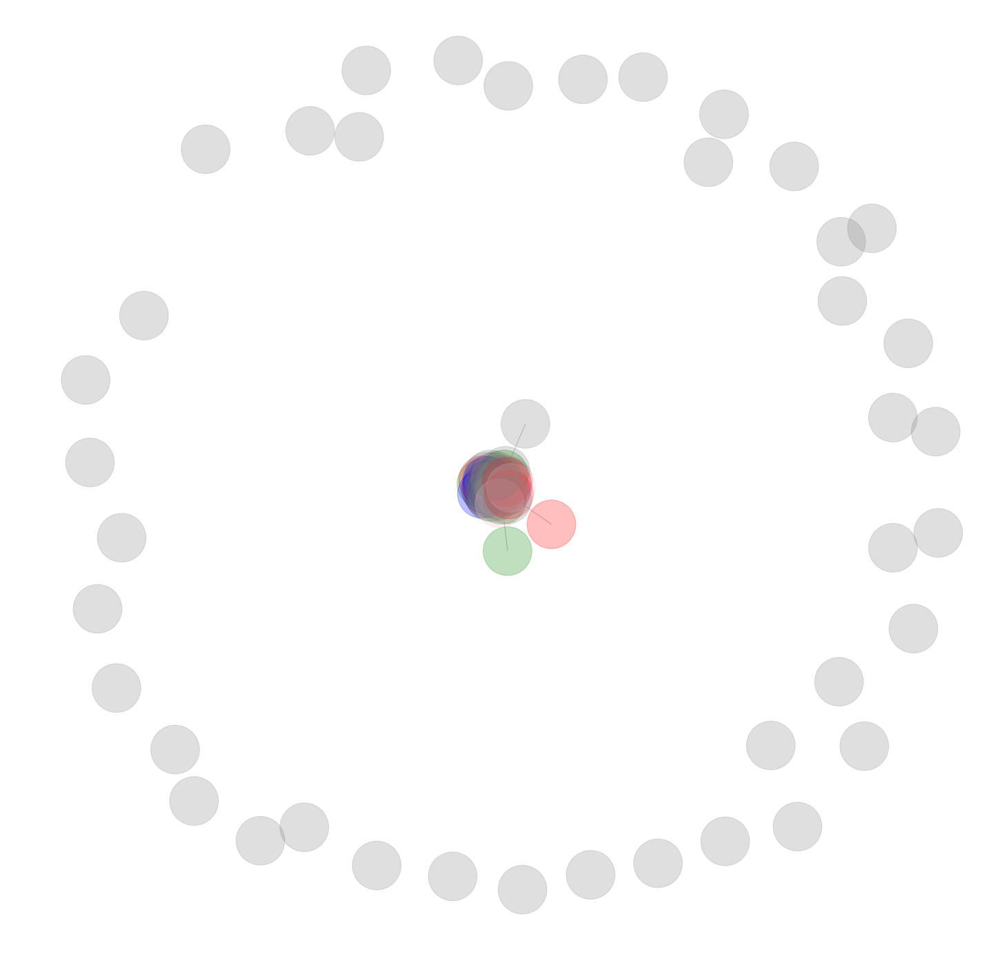

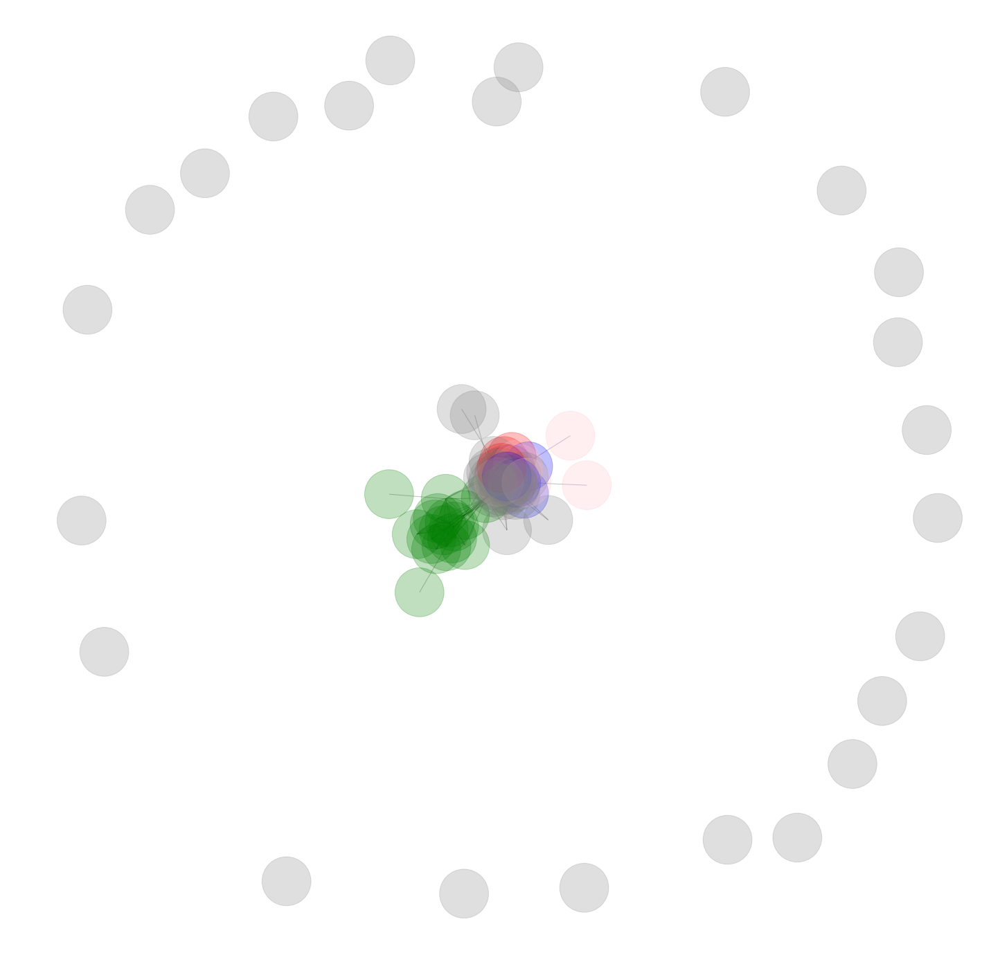

In [41]:
G1 = adj_mat_to_graph(adj_mats[0], 80)
G2 = adj_mat_to_graph(adj_mats[], 80)

CNM_subgraphs1 = map(list, community.greedy_modularity_communities(G1))
CNM_subgraphs2 = map(list, community.greedy_modularity_communities(G2))
print len(CNM_subgraphs1), len(CNM_subgraphs2)

clust_num_thresh = 4
large_CNM_subgraphs1 = []
for i in CNM_subgraphs1:
    if len(i) >= clust_num_thresh:
        large_CNM_subgraphs1 += [i]
large_CNM_subgraphs2 = []
for i in CNM_subgraphs2:
    if len(i) >= clust_num_thresh:
        large_CNM_subgraphs2 += [i]
print len(large_CNM_subgraphs1), len(large_CNM_subgraphs2)

color_map1 = []
for node in G1:
    if node in large_CNM_subgraphs1[0]:
        color_map1 += ['green']
    elif node in large_CNM_subgraphs1[1]:
        color_map1 += ['red'] 
    elif node in large_CNM_subgraphs1[2]:
        color_map1 += ['blue'] 
    elif node in large_CNM_subgraphs1[3]:
        color_map1 += ['pink'] 
    else:
        color_map1 += ['grey'] 
fig, ax = plt.subplots(figsize=(25, 25))
nx.draw(G1, ax=ax, node_color=color_map1, node_size=5000, alpha=0.25)
fig.show()
    
    
color_map2 = []
for node in G2:
    if node in large_CNM_subgraphs2[0]:
        color_map2 += ['green']
    elif node in large_CNM_subgraphs2[1]:
        color_map2 += ['pink'] 
    elif node in large_CNM_subgraphs2[2]:
        color_map2 += ['blue'] 
    elif node in large_CNM_subgraphs2[3]:
        color_map2 += ['red'] 
    else:
        color_map2 += ['grey'] 
fig, ax = plt.subplots(figsize=(25, 25))
nx.draw(G2, ax=ax, node_color=color_map2, node_size=5000, alpha=0.25)
fig.show()